# Police Fatalities in the US From 2000 To 2020

Data obtained from Kaggle: https://www.kaggle.com/datasets/djonafegnem/police-fatalities-in-the-us-from-2000-to-2020

GitHub link: https://github.com/samantharivas/Police_Fatalities.git

Business objective: 

## Import Libaries

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns

import dmba
from dmba import regressionSummary, gainsChart, liftChart
from dmba import adjusted_r2_score, AIC_score, BIC_score

from sklearn.model_selection import GridSearchCV

from sklearn.metrics import confusion_matrix, accuracy_score, ConfusionMatrixDisplay, classification_report, f1_score
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.preprocessing import OneHotEncoder
from sklearn.impute import SimpleImputer

from statsmodels.stats.outliers_influence import variance_inflation_factor

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import SelectKBest, chi2, f_classif
from sklearn.linear_model import Perceptron, LogisticRegression

import scipy.stats as stats
from scipy.stats import chi2_contingency

import folium

from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

from sklearn.inspection import permutation_importance

from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import GridSearchCV
import scikitplot as skplt



import os

%matplotlib inline
import matplotlib.pylab as plt
import matplotlib 
import matplotlib.ticker as mticker

import warnings
warnings.filterwarnings("ignore") #supress warnings

## Import Dataset

In [3]:
# download datset from Kaggle
police_df = pd.read_csv('police_fatalities.csv') # read csv file 

# rename columns by replacing spaces with underscores
police_df.columns = police_df.columns.str.replace(' ', '_')

# replace single quotes with an empty string in column names
police_df.columns = police_df.columns.str.replace("'", "")

In [4]:
# print 10 random samples from the dataframe 
police_df.sample(10)

,Unique_ID,Subjects_name,Subjects_age,Subjects_gender,Subjects_race,Subjects_race_with_imputations,Imputation_probability,URL_of_image_of_deceased,Date_of_injury_resulting_in_death_(month/day/year),Location_of_injury_(address),...,A_brief_description_of_the_circumstances_surrounding_the_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),Link_to_news_article_or_photo_of_official_document,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Video,Date&Description,Unique_ID_formula,Unique_identifier_(redundant),Date_(Year)
14034,23239,"Albert Ray ""Baby Ray"" Finch",70,Male,European-American/White,European-American/White,not imputed,https://www.fatalencounters.org/wp-content/upl...,04/01/2012,115 East Kingston Springs Rd,...,Deputy Ben Buselmeier shot and killed Albert F...,Unreported,"Intentional Use of Force, Deadly",http://www.wsmv.com/story/17307909/family-offi...,Yes,NaN,4/1/2012: Deputy Ben Buselmeier shot and kille...,NaN,23239.0,2012.0
25508,25469,Zayounta Zashon Washington,20,Male,African-American/Black,African-American/Black,not imputed,https://www.fatalencounters.org/wp-content/upl...,12/29/2018,1170 Northview Extension,...,Officers responded to a home on Northview Exte...,Pending investigation,No,https://www.ajc.com/news/crime--law/twice-days...,No,NaN,12/29/2018: Officers responded to a home on No...,NaN,25469.0,2018.0
14785,11820,Juan Eulogio Rodriguez,32,Male,Hispanic/Latino,Hispanic/Latino,not imputed,NaN,09/18/2012,I-10,...,Law enforcement disabled Rodriguez's 1992 Buic...,Ruled suicide,Suicide,https://drive.google.com/open?id=0B_YUrB_q0WyC...,Unknown,NaN,9/18/2012: Law enforcement disabled Rodriguez'...,NaN,11820.0,2012.0
12112,9616,Derrick Jones,37,Male,African-American/Black,African-American/Black,not imputed,http://oaklandnorth.net/wp-content/uploads/201...,11/08/2010,5800 block Trask Street,...,Police said Jones was shot after fleeing from ...,Justified,"Intentional Use of Force, Deadly",http://oaklandnorth.net/2010/11/09/east-oaklan...,No,NaN,11/8/2010: Police said Jones was shot after fl...,NaN,9616.0,2010.0
14651,11712,Martin Perez,22,Male,Hispanic/Latino,Hispanic/Latino,not imputed,NaN,08/17/2012,Seventh St. and Maritime St.,...,Martin Perez was killed after he crashed his c...,Unreported,Vehicle/Pursuit,http://sanfrancisco.cbslocal.com/2012/08/17/1-...,No,NaN,8/17/2012: Martin Perez was killed after he cr...,NaN,11712.0,2012.0
14485,19288,Devin Taylor,25,Male,African-American/Black,African-American/Black,not imputed,http://wistv.images.worldnow.com/images/190270...,07/14/2012,US 521 and Beckwood Rd,...,Trooper pulled over Devin Taylor for speeding....,Justified,"Intentional Use of Force, Deadly",http://www.wistv.com/story/19027097/police-inv...,Drug or alcohol use,NaN,7/14/2012: Trooper pulled over Devin Taylor fo...,NaN,19288.0,2012.0
4939,3952,Nathaniel L. Coleman,21,Male,European-American/White,European-American/White,not imputed,https://fatalencounters.org/wp-content/uploads...,01/31/2005,Homer Adams Parkway and East Broadway,...,Nathaniel L. Coleman was killed after he alleg...,Unreported,Vehicle/Pursuit,https://drive.google.com/file/d/0B-l9Ys3cd80fV...,No,NaN,1/31/2005: Nathaniel L. Coleman was killed aft...,NaN,3952.0,2005.0
23263,23281,Alyssa Mackenzie Bolick,29,Female,European-American/White,European-American/White,not imputed,https://www.fatalencounters.org/wp-content/upl...,09/30/2017,Battleground Ave & New Garden Rd,...,"At 11:27 p.m., a Guilford County Sheriff's dep...",Unreported,Vehicle/Pursuit,http://www.journalnow.com/news/local/killed-in...,No,NaN,"9/30/2017: At 11:27 p.m., a Guilford County Sh...",NaN,23281.0,2017.0
9394,21202,Kirk Cook,48,Male,European-American/White,European-American/White,not imputed,NaN,09/08/2008,3700 block Berkshire Ave,...,Police responded just before 4 p.m. to reports...,Unreported,"Intentional Use of Force, Deadly",http://www.hvacproforums.com/threads/its-a-fam...,No,NaN,9/8/2008: Police responded just

## Data Inspection

In [5]:
police_df.shape

(28335, 29)

In [6]:
police_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28335 entries, 0 to 28334
Data columns (total 29 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       28334 non-null  object 
 1   Subjects_name                                                   28335 non-null  object 
 2   Subjects_age                                                    27354 non-null  object 
 3   Subjects_gender                                                 28237 non-null  object 
 4   Subjects_race                                                   28334 non-null  object 
 5   Subjects_race_with_imputations                                  27905 non-null  object 
 6   Imputation_probability                                          27897 non-null  object 
 7   URL_of_image_of_deceased                         

In [7]:
# convert coolumns which contain numerical values into numeric data type 

columns_to_convert = ['Subjects_age', 'Latitude', 'Longitude','Location_of_death_(zip_code)', 
                      'Imputation_probability','Unique_identifier_(redundant)', 'Date_(Year)']

for col in columns_to_convert:
    police_df[col] = pd.to_numeric(police_df[col], errors='coerce')
    
police_df.info() #check data type after conversion 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28335 entries, 0 to 28334
Data columns (total 29 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       28334 non-null  object 
 1   Subjects_name                                                   28335 non-null  object 
 2   Subjects_age                                                    27294 non-null  float64
 3   Subjects_gender                                                 28237 non-null  object 
 4   Subjects_race                                                   28334 non-null  object 
 5   Subjects_race_with_imputations                                  27905 non-null  object 
 6   Imputation_probability                                          7029 non-null   float64
 7   URL_of_image_of_deceased                         

In [8]:
# convert the date column to a datetime format
police_df['Date_of_injury_resulting_in_death'] = pd.to_datetime(police_df['Date_of_injury_resulting_in_death_(month/day/year)'])

# extract month, day, and year into separate columns
police_df['Injury_Month'] = police_df['Date_of_injury_resulting_in_death'].dt.month
police_df['Injury_Day'] = police_df['Date_of_injury_resulting_in_death'].dt.day
police_df['Injury_Year'] = police_df['Date_of_injury_resulting_in_death'].dt.year

police_df.sample(10)

,Unique_ID,Subjects_name,Subjects_age,Subjects_gender,Subjects_race,Subjects_race_with_imputations,Imputation_probability,URL_of_image_of_deceased,Date_of_injury_resulting_in_death_(month/day/year),Location_of_injury_(address),...,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Video,Date&Description,Unique_ID_formula,Unique_identifier_(redundant),Date_(Year),Date_of_injury_resulting_in_death,Injury_Month,Injury_Day,Injury_Year
6051,4821,Donald Yates,45.0,Male,Race unspecified,European-American/White,0.947923,NaN,01/12/2006,1438 Chesterfield Drive,...,No,NaN,1/12/2006: Deputies responding to a domestic d...,NaN,4821.0,2006.0,2006-01-12,1,12,2006
6776,5380,Mark E. Taylor,46.0,Male,Race unspecified,African-American/Black,0.506221,NaN,08/13/2006,12016 E. Colfax Ave.,...,Unknown,NaN,8/13/2006: Police were called to the motel on ...,NaN,5380.0,2006.0,2006-08-13,8,13,2006
11863,9414,Eduardo Lopez-Hernandez,21.0,Male,Hispanic/Latino,Hispanic/Latino,NaN,https://fatalencounters.org/wp-content/uploads...,08/25/2010,Highway 95 and Charleston Overpass,...,Unknown,NaN,8/25/2010: Nevada Highway Patrol troopers resp...,NaN,9414.0,2010.0,2010-08-25,8,25,2010
17800,14693,Eric Tyler Johnson,16.0,Male,European-American/White,European-American/White,NaN,https://fatalencounters.org/wp-content/uploads...,06/23/2014,3892 Michigan Ave Rd NE,...,No,NaN,"6/23/2014: Eric Tyler Johnson, 16, was alleged...",NaN,14693.0,2014.0,2014-06-23,6,23,2014
7196,25912,Yvonne DesHotel,45.0,Female,Race unspecified,NaN,NaN,NaN,12/04/2006,1900 Washington St,...,No,NaN,"12/4/2006: A sheriff's deputy, Yvonne DesHotel...",NaN,25912.0,2006.0,2006-12-04,12,4,2006
19593,16422,Lee Aaron Gerston,33.0,Male,European-American/White,European-American/White,NaN,NaN,07/24/2015,1057 State Rd 1121,...,No,NaN,7/24/2015: Deputies opened fire on Gerston whe...,NaN,16422.0,2015.0,2015-07-24,7,24,2015
28195,28176,Thomas Jeffery Sutherlin,32.0,Male,European-American/White,European-American/White,NaN,NaN,05/31/2020,1731 S Church St,...,No,NaN,5/31/2020: An officer stopped a vehicle in Wat...,NaN,28176.0,2020.0,2020-05-31,5,31,2020
21868,18596,Terrence Toshay Thomas Jr.,19.0,Male,African-American/Black,African-American/Black,NaN,https://www.fatalencounters.org/wp-content/upl...,12/22/2016,4100 block Byers Street,...,No,NaN,12/22/2016: Police have not said why they were...,NaN,18596.0,2016.0,2016-12-22,12,22,2016
13405,10661,Larry Dean Smith,56.0,Male,European-American/White,European-American/White,NaN,http://www.wilsonfamilyfuneralhome.com/fh_live...,10/12/2011,Washington St & Victory Rd,...,Unknown,NaN,10/12/2011: Trooper Justin Rohr shot former dr...,NaN,10661.0,2011.0,2011-10-12,10,12,2011
20720,17489,Melissa Marie Miller,36.0,Female,European-American/White,European-American/White,NaN,https://www.fatalencounters.org/wp-content/upl...,03/30/2016,700 Avenger,...,No,NaN,3/30/2016: Driver Anthony Raymond Castillo and...,NaN,17489.0,2016.0,2016-03-30,3,30,2016


In [9]:
police_df.columns #column names within the df 

Index(['Unique_ID', 'Subjects_name', 'Subjects_age', 'Subjects_gender',
       'Subjects_race', 'Subjects_race_with_imputations',
       'Imputation_probability', 'URL_of_image_of_deceased',
       'Date_of_injury_resulting_in_death_(month/day/year)',
       'Location_of_injury_(address)', 'Location_of_death_(city)',
       'Location_of_death_(state)', 'Location_of_death_(zip_code)',
       'Location_of_death_(county)', 'Full_Address', 'Latitude', 'Longitude',
       'Agency_responsible_for_death', 'Cause_of_death',
       'A_brief_description_of_the_circumstances_surrounding_the_death',
       'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS',
       'Intentional_Use_of_Force_(Developing)',
       'Link_to_news_article_or_photo_of_official_document',
       'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS', 'Video',
       'Date&Description', 'Unique_ID_formula',
       'Unique_identifier_(redundant)', 'Date_(Year)',
       'Date_of_injury_resulting_in_death', 'Injur

In [10]:
police_df.nunique() #number of unique values within each column 

Unique_ID                                                         28334
Subjects_name                                                     26982
Subjects_age                                                         97
Subjects_gender                                                       3
Subjects_race                                                         8
Subjects_race_with_imputations                                        9
Imputation_probability                                             6954
URL_of_image_of_deceased                                          12857
Date_of_injury_resulting_in_death_(month/day/year)                 7182
Location_of_injury_(address)                                      26026
Location_of_death_(city)                                           5940
Location_of_death_(state)                                            51
Location_of_death_(zip_code)                                      10460
Location_of_death_(county)                                      

In [11]:
police_df.kurtosis() # shape of distribution of numeric columns 

Subjects_age                     0.528233
Imputation_probability           0.079034
Location_of_death_(zip_code)    -1.272116
Latitude                         1.737740
Longitude                       -0.157605
Unique_ID_formula                     NaN
Unique_identifier_(redundant)   -1.200000
Date_(Year)                      0.842675
Injury_Month                    -1.167422
Injury_Day                      -1.192541
Injury_Year                      0.836232
dtype: float64

## Exploratory Data Analysis

### Handling Missing Data 

In [12]:
#identify missing values in each column 
police_df.isnull().sum()  

Unique_ID                                                             1
Subjects_name                                                         0
Subjects_age                                                       1041
Subjects_gender                                                      98
Subjects_race                                                         1
Subjects_race_with_imputations                                      430
Imputation_probability                                            21306
URL_of_image_of_deceased                                          15424
Date_of_injury_resulting_in_death_(month/day/year)                    0
Location_of_injury_(address)                                        542
Location_of_death_(city)                                             36
Location_of_death_(state)                                             1
Location_of_death_(zip_code)                                        190
Location_of_death_(county)                                      

In [13]:
# calculate missing values as a percentage of total data 
missing_percentage = (police_df.isnull().sum() / len(police_df)) * 100
missing_percentage = missing_percentage.sort_values(ascending=False)

print('Missing Value Percentage per Column:')
print(missing_percentage)

Missing Value Percentage per Column:
Unique_ID_formula                                                 99.992942
Video                                                             99.989412
Imputation_probability                                            75.193224
URL_of_image_of_deceased                                          54.434445
Subjects_age                                                       3.673902
Location_of_injury_(address)                                       1.912829
Subjects_race_with_imputations                                     1.517558
Location_of_death_(zip_code)                                       0.670549
Subjects_gender                                                    0.345862
Agency_responsible_for_death                                       0.243515
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS         0.218811
Location_of_death_(city)                                           0.127051
Date&Description                                   

The columns which have a majority of their rows missing (50% and above), to maintain the integrity of the data, they will be dropped instead of imputed.

In [14]:
# drop columns where more than 50% of the data is missing 

# identify columns with more than 50% missing values
columns = missing_percentage[missing_percentage > 50]
columns_to_drop = missing_percentage[missing_percentage > 50].index

print('Columns with More than 50% Missing Values:')
print(columns)

Columns with More than 50% Missing Values:
Unique_ID_formula           99.992942
Video                       99.989412
Imputation_probability      75.193224
URL_of_image_of_deceased    54.434445
dtype: float64


In [15]:
# drop the identified columns from the DataFrame
police_df.drop(columns=columns_to_drop, inplace=True)

Remaining of the missing values will be filled with the 'most frequent' value using a SimpleImputer.

In [16]:
# use SimpleImputer to replace the NaN values with the 'most frequent value '
imp = SimpleImputer(strategy = 'most_frequent')

In [17]:
# fit and transform the data replacing the NaN values of each feature with the
# 'most frequent' value of each feature
imputed_df = imp.fit_transform(police_df)

In [18]:
# obtain column names from original df
column_names = police_df.columns

# create a df from the imputed_data array
imputed_df = pd.DataFrame(imputed_df, columns=column_names)

imputed_df.head()

,Unique_ID,Subjects_name,Subjects_age,Subjects_gender,Subjects_race,Subjects_race_with_imputations,Date_of_injury_resulting_in_death_(month/day/year),Location_of_injury_(address),Location_of_death_(city),Location_of_death_(state),...,Intentional_Use_of_Force_(Developing),Link_to_news_article_or_photo_of_official_document,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Date&Description,Unique_identifier_(redundant),Date_(Year),Date_of_injury_resulting_in_death,Injury_Month,Injury_Day,Injury_Year
0,25746,Samuel H. Knapp,17.0,Male,European-American/White,European-American/White,01/01/2000,27898-27804 US-101,Willits,CA,...,Vehicle/Pursuit,https://drive.google.com/file/d/10DisrV8K5ReP1...,No,1/1/2000: Samuel Knapp was allegedly driving a...,25746.0,2000.0,2000-01-01,1,1,2000
1,25747,Mark A. Horton,21.0,Male,African-American/Black,African-American/Black,01/01/2000,Davison Freeway,Detroit,MI,...,Vehicle/Pursuit,https://drive.google.com/file/d/1-nK-RohgiM-tZ...,No,1/1/2000: Two Detroit men killed when their ca...,25747.0,2000.0,2000-01-01,1,1,2000
2,25748,Phillip A. Blurbridge,19.0,Male,African-American/Black,African-American/Black,01/01/2000,Davison Freeway,Detroit,MI,...,Vehicle/Pursuit,https://drive.google.com/file/d/1-nK-RohgiM-tZ...,No,1/1/2000: Two Detroit men killed when their ca...,25748.0,2000.0,2000-01-01,1,1,2000
3,25749,Mark Ortiz,23.0,Male,Hispanic/Latino,Hispanic/Latino,01/01/2000,600 W Cherry Ln,Carlsbad,NM,...,Vehicle/Pursuit,https://drive.google.com/file/d/1qAEefRjX_aTtC...,No,1/1/2000: A motorcycle was allegedly being dri...,25749.0,2000.0,2000-01-01,1,1,2000
4,2,Lester Miller,53.0,Male,Race unspecified,African-American/Black,01/02/2000,4850 Flakes Mill Road,Ellenwood,GA,...,"Intentional Use of Force, Deadly",https://docs.google.com/document/d/1-YuShSarW_...,No,"1/2/2000: Darren Mayfield, a DeKalb County she...",2.0,2000.0,2000-01-02,1,2,2000


### Removing Duplicate Values

In [19]:
# identify number of duplicates in the df  
duplicates = imputed_df.duplicated()

# display rows with duplicates
duplicates = imputed_df.duplicated()
count_duplicates = duplicates.sum()
print("Count of Duplicate Rows:", count_duplicates)

Count of Duplicate Rows: 0


Data frame has zero duplicate values, thus all values remain. 

### Dropping Columns 

In [20]:
# drop redudant columns that will not be used for modeling 

imputed_df.drop(columns=['Unique_identifier_(redundant)', 'Link_to_news_article_or_photo_of_official_document', 
                        'Subjects_race_with_imputations', 'Subjects_name', 'Date&Description', 
                        'Full_Address', 'Date_(Year)', 'Date_of_injury_resulting_in_death', 'Injury_Day', 
                        'Date_of_injury_resulting_in_death_(month/day/year)'],inplace=True)

imputed_df.head()

,Unique_ID,Subjects_age,Subjects_gender,Subjects_race,Location_of_injury_(address),Location_of_death_(city),Location_of_death_(state),Location_of_death_(zip_code),Location_of_death_(county),Latitude,Longitude,Agency_responsible_for_death,Cause_of_death,A_brief_description_of_the_circumstances_surrounding_the_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Injury_Month,Injury_Year
0,25746,17.0,Male,European-American/White,27898-27804 US-101,Willits,CA,95490.0,Mendocino,39.470883,-123.361751,Mendocino County Sheriff's Office,Vehicle,Samuel Knapp was allegedly driving a stolen ve...,Unreported,Vehicle/Pursuit,No,1,2000
1,25747,21.0,Male,African-American/Black,Davison Freeway,Detroit,MI,48203.0,Wayne,42.404526,-83.092274,Los Angeles Police Department,Vehicle,Two Detroit men killed when their car crashed ...,Unreported,Vehicle/Pursuit,No,1,2000
2,25748,19.0,Male,African-American/Black,Davison Freeway,Detroit,MI,48203.0,Wayne,42.404526,-83.092274,Los Angeles Police Department,Vehicle,Two Detroit men killed when their car crashed ...,Unreported,Vehicle/Pursuit,No,1,2000
3,25749,23.0,Male,Hispanic/Latino,600 W Cherry Ln,Carlsbad,NM,88220.0,Eddy,32.45008,-104.237643,Eddy County Sheriff's Office,Vehicle,A motorcycle was allegedly being driven errati...,Unreported,Vehicle/Pursuit,No,1,2000
4,2,53.0,Male,Race unspecified,4850 Flakes Mill Road,Ellenwood,GA,30294.0,DeKalb,33.645164,-84.229413,DeKalb County Sheriff's Office,Gunshot,"Darren Mayfield, a DeKalb County sheriff's dep...",Criminal,"Intentional Use of Force, Deadly",No,1,2000


## Data Visualizations


#### Map Visualizations - Subset Dataset to California 

In [21]:
# create United States map with incidents based on longitude and latitude values - sorted by gender 

# calculate the average latitude and longitude values 
average_latitude = imputed_df['Latitude'].mean()
average_longitude = imputed_df['Longitude'].mean()

# use the average coordinates as the center
latitude_center = average_latitude
longitude_center = average_longitude


us_map = folium.Map(location=[latitude_center, longitude_center], zoom_start=3)

# add markers for each location using latitude and longitude based on identified gender 
for index, row in imputed_df.iterrows():
    gender = row["Subjects_gender"]
    color = 'blue' if gender == 'Male' else 'red' if gender == 'Female' else 'gray' 

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,  
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        tooltip=f"Gender: {gender}"
    ).add_to(us_map)

# display map
us_map

In [22]:
# create subset for California data 
ca_df = imputed_df[imputed_df['Location_of_death_(state)'] == 'CA']

#drop location by state and zip code
ca_df = ca_df.drop(columns=['Location_of_death_(state)', 'Location_of_death_(zip_code)'])

ca_df.sample(10)

,Unique_ID,Subjects_age,Subjects_gender,Subjects_race,Location_of_injury_(address),Location_of_death_(city),Location_of_death_(county),Latitude,Longitude,Agency_responsible_for_death,Cause_of_death,A_brief_description_of_the_circumstances_surrounding_the_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Injury_Month,Injury_Year
872,671,17.0,Male,Hispanic/Latino,500 W Bard Rd,Oxnard,Ventura,34.159094,-119.182326,Oxnard Police Department,Gunshot,Lopez was shot to death by a SWAT member as he...,Justified,"Intentional Use of Force, Deadly",Yes,1,2001
25819,25642,20.0,Female,Hispanic/Latino,1000 block E Laurel Dr,Salinas,Monterey,36.682723,-121.621283,Salinas Police Department,Gunshot,Officers responded to reports of a disturbance...,Pending investigation,"Intentional Use of Force, Deadly",No,3,2019
967,750,38.0,Male,African-American/Black,10210 S. Western Ave.,Los Angeles,Los Angeles,33.943592,-118.309032,Los Angeles County Sheriff's Department,Gunshot,"Robert Eugene Jones Jr., a 38-year-old black m...",Unreported,"Intentional Use of Force, Deadly",Unknown,2,2001
1761,1391,22.0,Male,Race unspecified,6151 Freeport Boulevard,Sacramento,Sacramento,38.514192,-121.500576,Sacramento Police Department,Gunshot,Douglas Hause reportedly shot himself after a ...,Suicide,Suicide,Unknown,12,2001
7814,6194,21.0,Male,Race unspecified,27300 block 3rd Street,Highland,San Bernardino,34.106212,-117.208649,San Bernardino Police Department,Gunshot,"Officers David Green, Adam Affrunti and Von Ve...",Justified,"Intentional Use of Force, Deadly",Unknown,6,2007
13001,10330,36.0,Male,European-American/White,6139 Rosebay St,Long Beach,Los Angeles,33.813021,-118.111437,Long Beach Police Department,Gunshot,Officers reported that they responded to a hos...,Unreported,"Intentional Use of Force, Deadly",Unknown,7,2011
18715,15589,25.0,Male,European-American/White,800 block Howard St,Stockton,San Joaquin,37.929792,-121.298139,Stockton Police Department,Gunshot,Wetter appeared to be intoxicated when he brok...,Unreported,"Intentional Use of Force, Deadly",Drug or alcohol use,1,2015
4092,3289,22.0,Male,Race unspecified,E Esplanade Ave & Vanessa Dr,San Jacinto,Riverside,33.772339,-116.943674,San Jacinto Police Department,Vehicle,Mathew Morris and Matthew Timm died when the s...,Unreported,Vehicle/Pursuit,Unknown,4,2004
26790,26585,35.0,Male,Hispanic/Latino,25200 block Rye Canyon Rd,Santa Clarita,Los Angeles,34.439313,-118.574874,Los Angeles County Sheriff's Department,Gunshot,Deputies responded to reports of a person acti...,Pending investigation,"Intentional Use of Force, Deadly",Unknown,9,2019
4350,3495,36.0,Male,Hispanic/Latino,CA-99 and Peltier Road,Acampo,San Joaquin,38.189869,-121.316598,San Joaquin County Sheriff's Office,Gunshot,Deputy Aaron Dunsing shot and killed Raul Hern...,Unreported,"Intentional Use of Force, Deadly",Unknown,7,2004


In [23]:
# convert coolumns which contain numerical values into numeric data type 

columns_to_convert = ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year', 'Injury_Month']

for col in columns_to_convert:
    ca_df[col] = pd.to_numeric(ca_df[col], errors='coerce')
    
ca_df.info() #check data type after conversion 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4549 entries, 0 to 28334
Data columns (total 17 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       4549 non-null   object 
 1   Subjects_age                                                    4549 non-null   float64
 2   Subjects_gender                                                 4549 non-null   object 
 3   Subjects_race                                                   4549 non-null   object 
 4   Location_of_injury_(address)                                    4549 non-null   object 
 5   Location_of_death_(city)                                        4549 non-null   object 
 6   Location_of_death_(county)                                      4549 non-null   object 
 7   Latitude                                          

In [24]:
# create a map of califronia incidents to find outliers 

# calculate the average latitude and longitude values 
average_latitude = ca_df['Latitude'].mean()
average_longitude = ca_df['Longitude'].mean()

# use the average coordinates as the center
latitude_center = average_latitude
longitude_center = average_longitude


ca_map = folium.Map(location=[latitude_center, longitude_center], zoom_start=5)

# add markers for each location using latitude and longitude based on identified gender 
for index, row in ca_df.iterrows():
    gender = row["Subjects_gender"]
    color = 'blue' if gender == 'Male' else 'red' if gender == 'Female' else 'gray' 

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,  
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        tooltip=f"Gender: {gender}"
    ).add_to(ca_map)

# display map
ca_map

From the map we can identify outliers within longitude and latitude, these will be removed from the dataframe.

#### Pair Plot

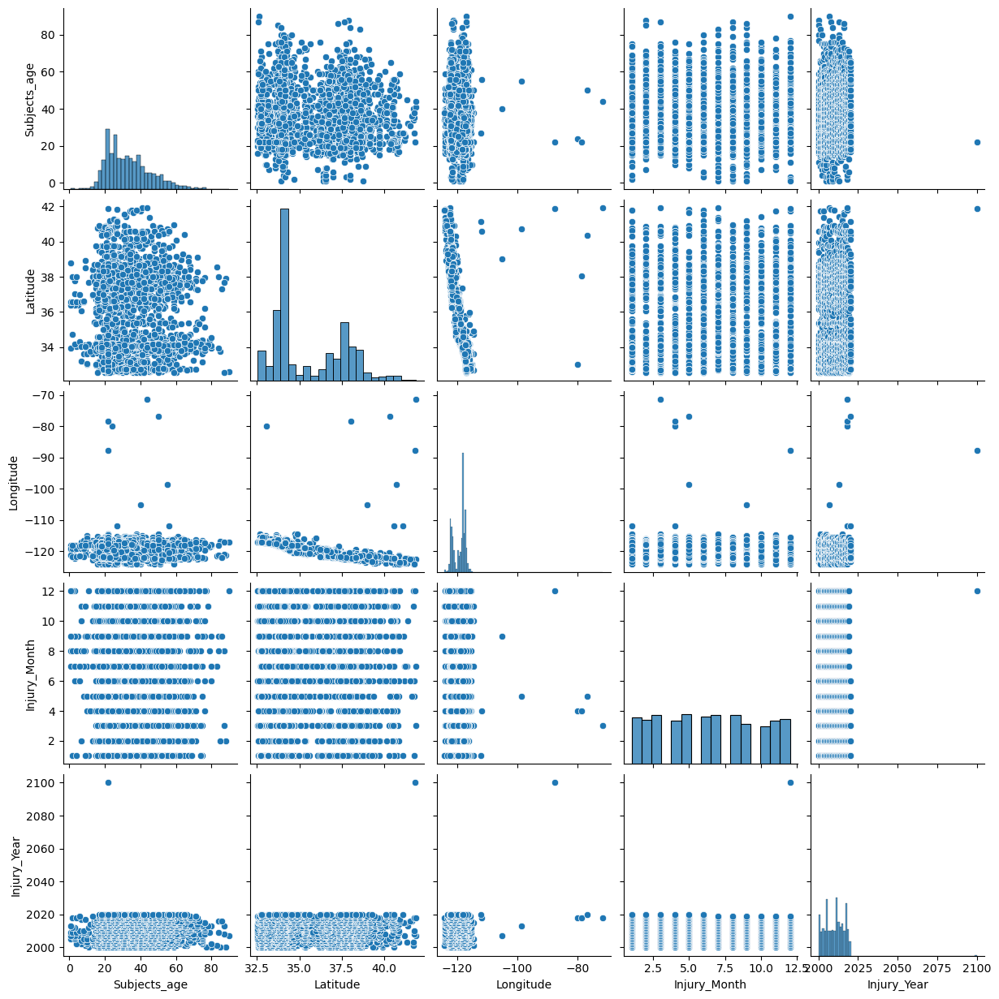

In [25]:
# reset the index to remove any duplicate labels
ca_df.reset_index(drop=True, inplace=True)

# create a pair plot
sns.pairplot(ca_df)
plt.show()

#### Box Plots

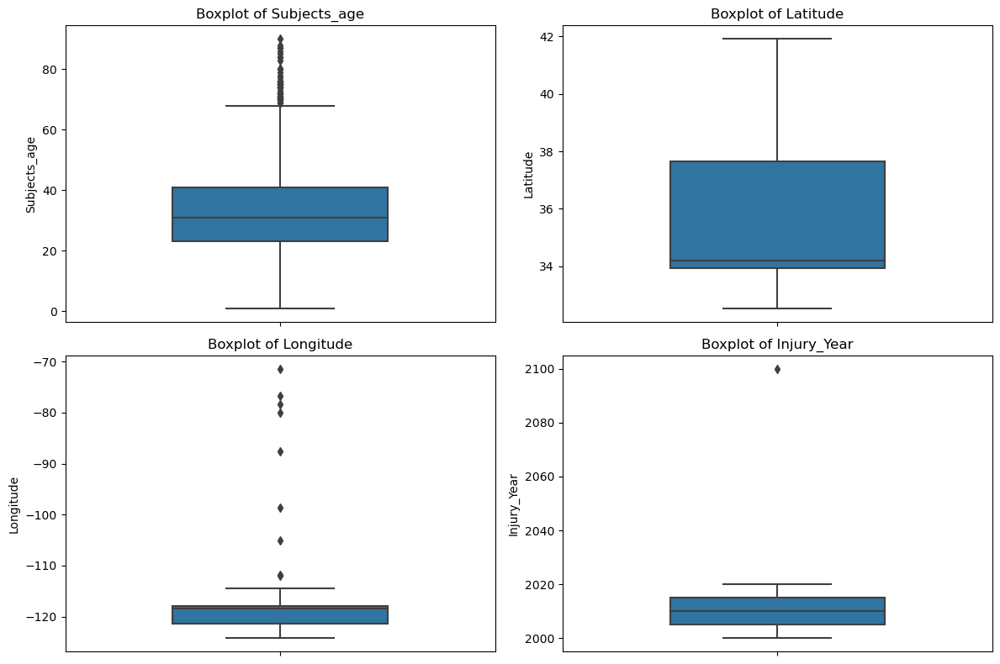

In [26]:
# List of numerical predictors
predictors = ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year']

# create boxplots 
plt.figure(figsize=(12, 8))  

for i, predictor in enumerate(predictors):
    plt.subplot(2, 2, i + 1)  
    sns.boxplot(data=ca_df, y=predictor, width=0.5)
    plt.title(f'Boxplot of {predictor}')
    plt.ylabel(predictor)

plt.tight_layout()  
plt.show()

The column 'Injury_Year' appears to have an outlier, the column will be reflected to only show data collected form 2000-2020. 

#### Bar Plots

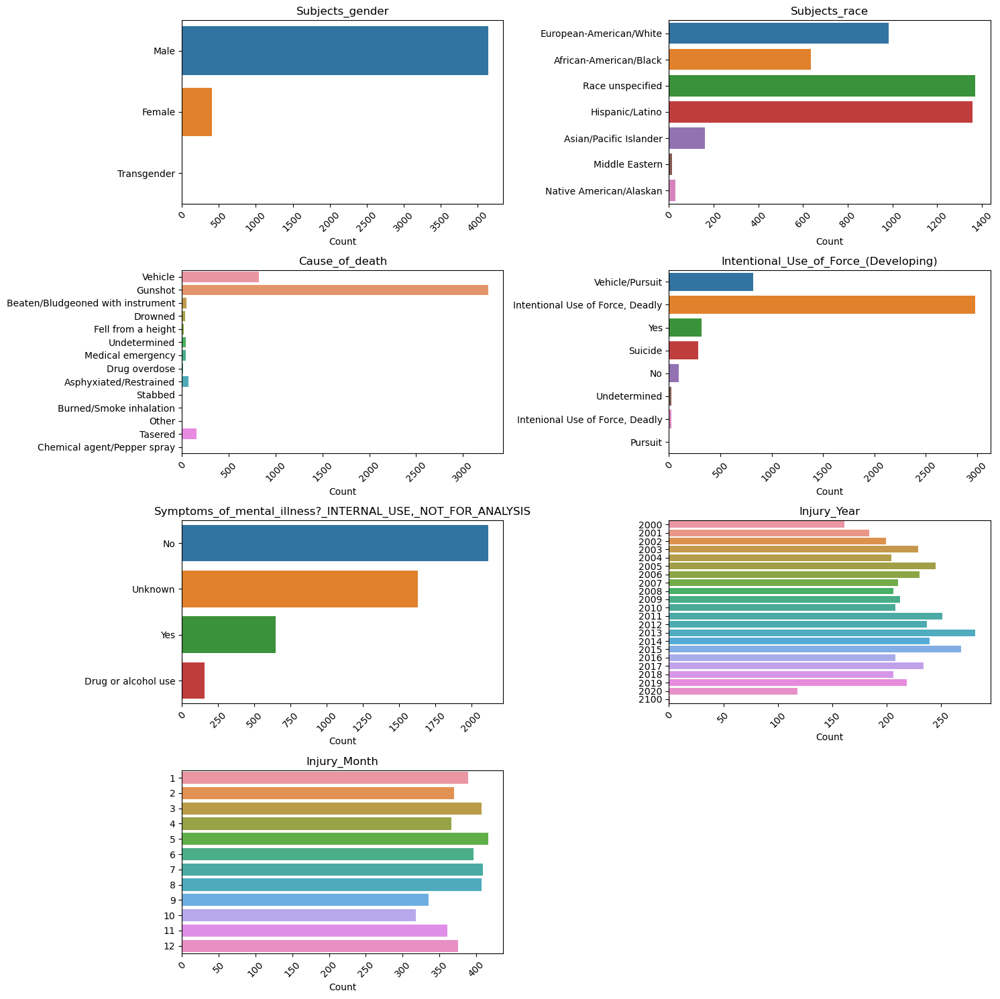

In [27]:
# list of selected columnsfor bar plot 
selected_columns =['Subjects_gender', 'Subjects_race', 'Cause_of_death', 'Intentional_Use_of_Force_(Developing)',
                   'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS', 'Injury_Year', 'Injury_Month']

# calculate the number of rows and columns for the subplot grid
num_cols = 2
num_rows = (len(selected_columns) - 1) // num_cols + 1

# create subplots and flatten axis
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))
axes = axes.flatten()

# iterate through selected columns and create horizontal countplots
for i, column in enumerate(selected_columns):
    sns.countplot(data=ca_df, y=column, ax=axes[i])
    axes[i].tick_params(axis='x', rotation=45)  

    axes[i].set_title(f'{column}')
    axes[i].set_xlabel('Count')
    axes[i].set_ylabel('')

# remove empty subplots
for i in range(len(selected_columns), num_rows * num_cols):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

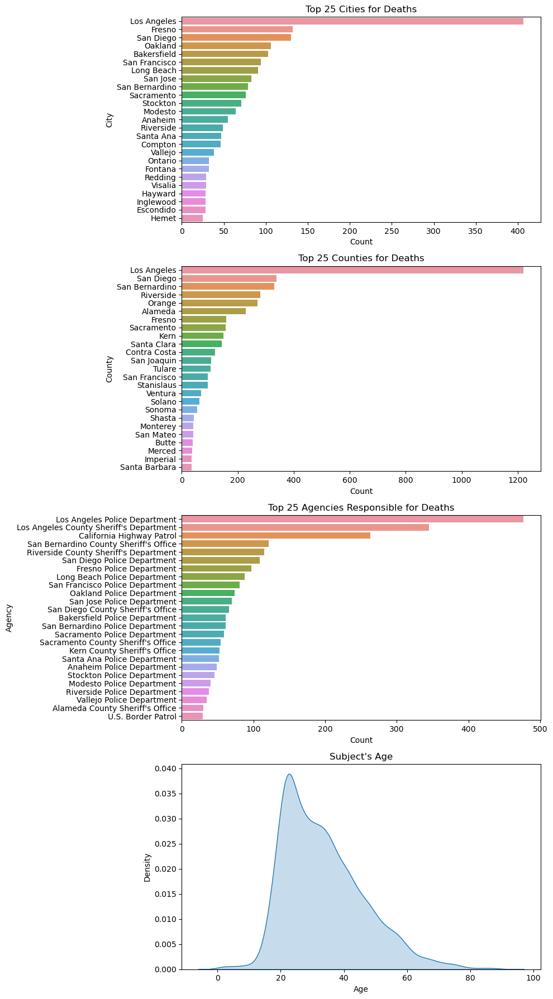

In [28]:
# create figure with subplots
fig, axes = plt.subplots(4, 1, figsize=(10, 18))

# first suplot - top 25 cities for deaths 
sns.countplot(data=ca_df, y='Location_of_death_(city)', 
              order=ca_df['Location_of_death_(city)'].value_counts().index[:25], ax=axes[0])
axes[0].set_xlabel('Count')
axes[0].set_ylabel('City')
axes[0].set_title('Top 25 Cities for Deaths')


# second subplot - top 25 counties for deaths 
sns.countplot(data=ca_df, y='Location_of_death_(county)', 
              order=ca_df['Location_of_death_(county)'].value_counts().index[:25], ax=axes[1])
axes[1].set_xlabel('Count')
axes[1].set_ylabel('County')
axes[1].set_title('Top 25 Counties for Deaths')

# third suplot - top 25 agencies responsible for deaths 
sns.countplot(data=ca_df, y='Agency_responsible_for_death', 
              order=ca_df['Agency_responsible_for_death'].value_counts().index[:25], ax=axes[2])
axes[2].set_xlabel('Count')
axes[2].set_ylabel('Agency')
axes[2].set_title('Top 25 Agencies Responsible for Deaths')


# fourth suplot - subjects age 
sns.kdeplot(data=ca_df, x='Subjects_age', fill=True, ax=axes[3])
axes[3].set_xlabel('Age')
axes[3].set_ylabel('Density')
axes[3].set_title('Subject\'s Age')


# Adjust subplot spacing
plt.tight_layout()

# Show the combined plot
plt.show()

#### Line Plot (Trend of Deaths)

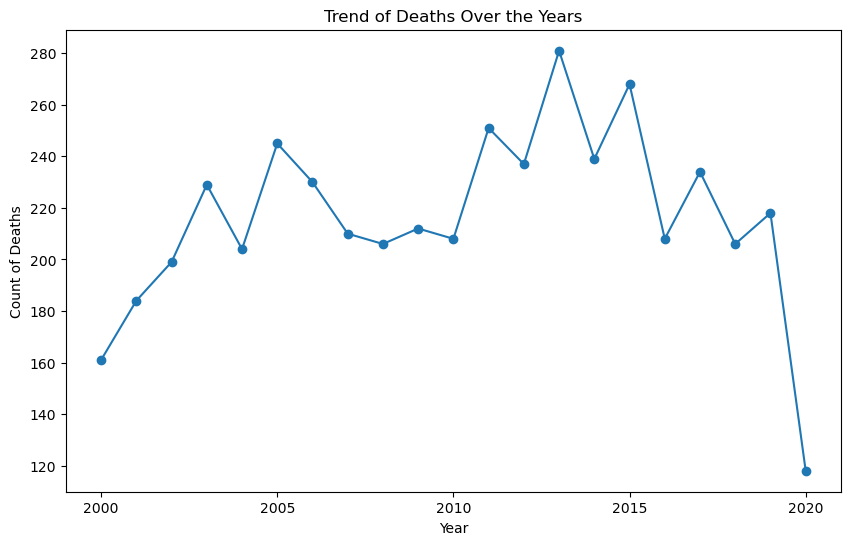

In [29]:
# per boxplot, the years will be filtered to 2000-2020 
ca_df = ca_df[(ca_df['Injury_Year'] >= 2000) & (ca_df['Injury_Year'] <= 2020)]

yearly_deaths = ca_df['Injury_Year'].value_counts().sort_index()

# create a line plot for the trend
plt.figure(figsize=(10, 6))
plt.plot(yearly_deaths.index, yearly_deaths.values, marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Count of Deaths')
plt.title('Trend of Deaths Over the Years')

# set x-axis ticks to display every 5 years from 2000 to 2020
plt.xticks(range(2000, 2021, 5))


plt.grid(False)
plt.show()

### Removing Outliers 

In [30]:
# removing outliers from 'longitude' and 'latitude' 

# calculate the interquartile range (IQR) for latitude and longitude to remove outliers 
Q1_latitude = ca_df['Latitude'].quantile(0.25)
Q3_latitude = ca_df['Latitude'].quantile(0.75)
IQR_latitude = Q3_latitude - Q1_latitude

Q1_longitude = ca_df['Longitude'].quantile(0.25)
Q3_longitude = ca_df['Longitude'].quantile(0.75)
IQR_longitude = Q3_longitude - Q1_longitude

# define the lower and upper bounds using IQR
latitude_lower_bound = Q1_latitude - 1.5 * IQR_latitude
latitude_upper_bound = Q3_latitude + 1.5 * IQR_latitude

longitude_lower_bound = Q1_longitude - 1.5 * IQR_longitude
longitude_upper_bound = Q3_longitude + 1.5 * IQR_longitude

# filter df based on IQR
filtered_df = ca_df[
    (ca_df['Latitude'] >= latitude_lower_bound) &
    (ca_df['Latitude'] <= latitude_upper_bound) &
    (ca_df['Longitude'] >= longitude_lower_bound) &
    (ca_df['Longitude'] <= longitude_upper_bound)
]

In [31]:
# removing outliers from 'subjects_age'
ca_df['Subjects_age'].unique()

array([17., 24., 31., 28., 41., 25., 26., 22., 35., 20., 88., 40., 85.,
       42., 50., 43., 27., 29., 46., 59., 51., 36., 18., 23., 38., 44.,
       34., 33., 39., 30., 37., 45., 16., 47., 53., 55., 54., 19., 80.,
       11., 32., 52., 48., 21., 77., 14., 66., 15., 60., 56., 58., 83.,
        9., 65., 57.,  7., 62., 10., 49.,  4., 75., 67., 63., 69., 74.,
       70., 68., 61., 13.,  8.,  1., 72.,  3., 71., 64.,  5., 90., 87.,
       76.,  2., 79., 84.,  6., 78., 12., 86., 73.])

In [32]:
# calculate the interquartile range (IQR) for latitude and longitude to remove outliers 
Q1_latitude = ca_df['Subjects_age'].quantile(0.25)
Q3_latitude = ca_df['Subjects_age'].quantile(0.75)
IQR_latitude = Q3_latitude - Q1_latitude


# define the lower and upper bounds using IQR
latitude_lower_bound = Q1_latitude - 1.5 * IQR_latitude
latitude_upper_bound = Q3_latitude + 1.5 * IQR_latitude

# filter df based on IQR
filtered_df = ca_df[
    (ca_df['Subjects_age'] >= latitude_lower_bound) &
    (ca_df['Subjects_age'] <= latitude_upper_bound)] 

### Contigency Tables

In [33]:
# define target column 
target_column = 'Cause_of_death'

# create an empty array to store the results
chi2_results = []

# iterate through all columns (without the target column)
for column in ca_df.columns:
    if column != target_column:
        cross_tab = pd.crosstab(index=ca_df[column], columns=ca_df[target_column])
        chi2, p, dof, expected = chi2_contingency(cross_tab)
        chi2_results.append({
            'Variable': column,
            'Chi-Square Value': chi2,
            'P-Value': p,
            'Degrees of Freedom': dof
        })

# display results 
chi2_df = pd.DataFrame(chi2_results)
chi2_df

,Variable,Chi-Square Value,P-Value,Degrees of Freedom
0,Unique_ID,59124.000000,4.841482e-01,59111
1,Subjects_age,1710.108426,1.275170e-27,1118
2,Subjects_gender,499.696272,4.030832e-89,26
3,Subjects_race,191.762870,1.449316e-11,78
4,Location_of_injury_(address),55884.447874,4.379805e-02,55315
5,Location_of_death_(city),10834.579335,1.137971e-32,9139
6,Location_of_death_(county),1283.730930,1.245392e-36,702
7,Latitude,57265.138598,4.869947e-08,55471
8,Longitude,57265.138598,3.929518e-08,55458
9,Agency_responsible_for_death,9231.163126,2.482851e-39,7514


In [34]:
# define target column 
target_column = 'Intentional_Use_of_Force_(Developing)'

# create an empty array to store the results
chi2_results = []

# iterate through all columns (without the target column)
for column in ca_df.columns:
    if column != target_column:
        cross_tab = pd.crosstab(index=ca_df[column], columns=ca_df[target_column])
        chi2, p, dof, expected = chi2_contingency(cross_tab)
        chi2_results.append({
            'Variable': column,
            'Chi-Square Value': chi2,
            'P-Value': p,
            'Degrees of Freedom': dof
        })

# display results 
chi2_df = pd.DataFrame(chi2_results)
chi2_df

,Variable,Chi-Square Value,P-Value,Degrees of Freedom
0,Unique_ID,31836.000000,4.878803e-01,31829
1,Subjects_age,973.562079,5.252351e-20,602
2,Subjects_gender,434.081105,8.213261e-84,14
3,Subjects_race,342.647123,8.687141e-49,42
4,Location_of_injury_(address),30890.816069,3.757128e-06,29785
5,Location_of_death_(city),7257.715397,1.040673e-94,4921
6,Location_of_death_(county),615.277636,1.318081e-13,378
7,Latitude,31376.689052,6.376562e-10,29869
8,Longitude,31376.689052,5.340616e-10,29862
9,Agency_responsible_for_death,7248.872701,7.372474e-186,4046


In [35]:
# create contigency table for 'Intentional_Use_of_Force_(Developing)' and 'Cause_of_death'
contingency_force = pd.crosstab(ca_df['Intentional_Use_of_Force_(Developing)'], ca_df ['Cause_of_death'])

contingency_force

Cause_of_death,Asphyxiated/Restrained,Beaten/Bludgeoned with instrument,Burned/Smoke inhalation,Chemical agent/Pepper spray,Drowned,Drug overdose,Fell from a height,Gunshot,Medical emergency,Other,Stabbed,Tasered,Undetermined,Vehicle
Intentional_Use_of_Force_(Developing),,,,,,,,,,,,,,
"Intenional Use of Force, Deadly",0,0,0,0,0,0,0,21,0,0,0,0,0,0
"Intentional Use of Force, Deadly",0,0,0,0,0,0,0,2977,0,1,1,0,0,0
No,0,1,0,0,35,12,13,0,29,0,2,0,3,0
Pursuit,0,0,0,0,0,0,0,0,0,0,0,0,0,4
Suicide,1,0,1,0,1,1,7,269,0,1,2,2,0,1
Undetermined,0,0,0,0,0,1,0,0,1,0,0,0,23,0
Vehicle/Pursuit,0,0,0,0,0,0,0,0,0,0,0,0,0,820
Yes,72,49,4,7,0,0,1,0,12,4,0,155,14,0


In [36]:
# create contigency table for 'Intentional_Use_of_Force_(Developing)' and 'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'
contingency_disposition = pd.crosstab(ca_df['Intentional_Use_of_Force_(Developing)'], ca_df['Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'])

contingency_disposition

"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Accidental,Administrative discipline,Administrative discipline/Civil suit/Family awarded money,Civil suit/Family awarded money,Civil suit/Pending,Civil suit/Results unreported,Cleared,Criminal,Criminal/Off-duty,Drug overdose,...,Pending investigation,Possible suicide,Possibly suicide,Ruled accidental,Ruled suicide,Ruled suicide by police,Suicide,Unknown,Unreported,Use of force justified
Intentional_Use_of_Force_(Developing),,,,,,,,,,,,,,,,,,,,,
"Intenional Use of Force, Deadly",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,2,19,0
"Intentional Use of Force, Deadly",2,2,2,6,1,0,53,19,1,0,...,740,1,1,0,0,1,0,162,1252,3
No,9,1,0,0,0,0,7,1,0,0,...,12,0,0,1,0,0,0,6,53,2
Pursuit,0,0,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,2,0
Suicide,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,67,0,219,0,0,0
Undetermined,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,23,0
Vehicle/Pursuit,8,1,0,1,0,1,31,62,0,0,...,88,0,0,1,0,0,0,53,565,0
Yes,12,0,0,1,1,1,57,2,0,1,...,61,0,0,1,0,0,0,13,134,0


In [37]:
# create contigency table for 'Cause_of_death' and 'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'
contingency_death = pd.crosstab(ca_df['Cause_of_death'], ca_df['Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'])

contingency_death

"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Accidental,Administrative discipline,Administrative discipline/Civil suit/Family awarded money,Civil suit/Family awarded money,Civil suit/Pending,Civil suit/Results unreported,Cleared,Criminal,Criminal/Off-duty,Drug overdose,...,Pending investigation,Possible suicide,Possibly suicide,Ruled accidental,Ruled suicide,Ruled suicide by police,Suicide,Unknown,Unreported,Use of force justified
Cause_of_death,,,,,,,,,,,,,,,,,,,,,
Asphyxiated/Restrained,4,0,0,0,0,0,17,0,0,0,...,15,0,0,0,0,0,1,4,26,0
Beaten/Bludgeoned with instrument,2,0,0,0,0,1,7,1,0,0,...,9,0,0,0,0,0,0,5,17,0
Burned/Smoke inhalation,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,1,0,3,0
Chemical agent/Pepper spray,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,5,0
Drowned,3,0,0,0,0,0,0,0,0,0,...,6,0,0,0,0,0,1,3,23,0
Drug overdose,4,1,0,0,0,0,2,0,0,0,...,0,0,0,0,0,0,1,1,4,0
Fell from a height,1,0,0,0,0,0,1,0,0,0,...,1,0,0,0,2,0,5,2,9,0
Gunshot,2,2,2,5,1,0,53,19,1,0,...,740,1,1,0,64,1,205,163,1271,3
Medical emergency,1,0,0,0,0,0,3,0,0,0,...,11,0,0,1,0,0,0,0,21,2


### ANOVA (Cause of Death and Numerical Values)

In [38]:
# ANOVA between numberical variables and Cause of Death 

for predictor in ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year']:
    grouped_data = [ca_df[predictor][ca_df['Cause_of_death'] == category] for category in ca_df['Cause_of_death'].unique()]
    f_statistic, p_value = stats.f_oneway(*grouped_data)
    print(f'{predictor} vs. Cause of Death:')
    print(f'F-statistic: {f_statistic}')
    print(f'P-value: {p_value}\n')

Subjects_age vs. Cause of Death:
F-statistic: 5.728529438692074
P-value: 1.4891504337475343e-10

Latitude vs. Cause of Death:
F-statistic: 3.7049401522931693
P-value: 6.624725458629456e-06

Longitude vs. Cause of Death:
F-statistic: 2.0464365900729953
P-value: 0.014292850594702793

Injury_Year vs. Cause of Death:
F-statistic: 5.123165376161279
P-value: 3.993013836667257e-09



### Text Analysis (brief description column)

In [39]:
corpus = ca_df['A_brief_description_of_the_circumstances_surrounding_the_death']

corpus.tail()

4543    Reports of a robbery at C.V. Guns & Tackle cam...
4544    About 1 a.m., deputies responded to a burglary...
4545    Around 9:30 a.m., deputies responded to a susp...
4546    Border Patrol agents briefly chased the car be...
4547    Louis Lane showed up at theWalmart distributio...
Name: A_brief_description_of_the_circumstances_surrounding_the_death, dtype: object

In [40]:
corpus.sample(20)

1889    15-year-old Devon Keeten, his brother Dylan Gr...
1620    Officers allege they responded to a call regar...
193     Bernice Martinez, Ashley Martinez, Christina M...
2906    Police opened fire on Gonzalez after an office...
1407    Sgt. Michael Moreno and probationary Officer B...
3030    Police responded to a 911 domestic disturbance...
188     Police were called to Chittick Field Park with...
1337    Vitaliy Nikolayevich Pugash died when his Suzu...
2071    Officers Daniel McAfee, Robert Pair and Michae...
3372    Linda Hull, was killed and her passenger suffe...
4532    Around 2:20 a.m., deputies responded after rec...
3567    Officers were patroling in the area of a small...
1680    Rivera was found to have been shot by his brot...
3844    Fremont police received a call from the East B...
2781    Perry Russell Coe reportedly shot himself in f...
1725    Police say that Cortez was reported to have ha...
1268    CHP officer Darren Long shot Bryan Richard Ros...
2834    SJPD's

In [41]:
corpus.describe()

count                                                  4548
unique                                                 4338
top       A car stolen at knifepoint and doing 80 MPH on...
freq                                                      8
Name: A_brief_description_of_the_circumstances_surrounding_the_death, dtype: object

In [42]:
# tfidfVectorizer
vectorizer = TfidfVectorizer()

# apply vectorizer tp corpus
spmat = vectorizer.fit_transform(corpus)

In [43]:
# create new df 'X'
X = pd.DataFrame.sparse.from_spmatrix(spmat)

In [44]:
labels = ca_df['Cause_of_death']

# subset labels that have text data present
text_subset = labels.loc[corpus.index]

text_subset

0                                 Vehicle
1                                 Vehicle
2                                 Gunshot
3       Beaten/Bludgeoned with instrument
4                                 Gunshot
                      ...                
4543                              Gunshot
4544                              Gunshot
4545                              Gunshot
4546                              Vehicle
4547                              Gunshot
Name: Cause_of_death, Length: 4548, dtype: object

In [45]:
# split the data
X_train, X_test, y_train, y_test = train_test_split(X, text_subset,
                                                    test_size=0.50)

In [46]:
# feature selection
X_new = SelectKBest(score_func=f_classif, k=10)

# fit selector on training data
X_new.fit(X_train, y_train)

# transform training and test data
X_train_selected = X_new.transform(X_train)
X_test_selected = X_new.transform(X_test)

In [47]:
print('Top 10 features %s' % X_train.columns[X_new.get_support()].tolist())

Top 10 features [3038, 3758, 3903, 5116, 6696, 8365, 8506, 8726, 9077, 10157]


In [48]:
# retrieve feature names
feature_names = vectorizer.get_feature_names_out()
selected_indices = X_new.get_support(indices=True)

# Top 10 selected words
print('Top 10 selected words:', [feature_names[i] for i in selected_indices])

Top 10 selected words: ['drowned', 'frances', 'gastelum', 'kerry', 'orzuna', 'shot', 'slitting', 'starting', 'tasered', 'yerby']


The 'A_brief_description_of_the_circumstances_surrounding_the_death' was deemed to be irrelevant and will be dropped from the df. 

In [49]:
ca_df.drop(columns=['A_brief_description_of_the_circumstances_surrounding_the_death'], inplace=True)

### Variable Importance

In [50]:
import pandas as pd
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Define the target variable
X_numeric = ca_df.select_dtypes(include=['float64', 'int64'])

# Create a DataFrame for VIF values
vif = pd.DataFrame()
vif["Variable"] = X_numeric.columns
vif["VIF"] = [variance_inflation_factor(X_numeric.values, i) for i in range(X_numeric.shape[1])]

# Display the VIF DataFrame
print(vif)

       Variable          VIF
0  Subjects_age     7.910802
1      Latitude   619.574063
2     Longitude  5247.403991
3  Injury_Month     4.490479
4   Injury_Year  3247.224988


From the variable importance, we can conclude the following columns ahould be dropped "Latitude', 'Longitude', and 'Injury_Year'. High multicollinaerity values such as those from the following columns can lead a reduction in interpretability and loss of variable importance for variables that are actually correlated with the target variable.

In [51]:
# drop redudant columns that will not be used for modeling/habe high VIF and low p-values 

ca_df.drop(columns=['Latitude', 'Longitude','Location_of_injury_(address)',
                    'Injury_Year'],inplace=True)

## Data Pre-Processing

In [52]:
ca_df['Intentional_Use_of_Force_(Developing)'].unique()

array(['Vehicle/Pursuit', 'Intentional Use of Force, Deadly', 'Yes',
       'Suicide', 'No', 'Undetermined', 'Intenional Use of Force, Deadly',
       'Pursuit'], dtype=object)

In [53]:
# map values into two actegories intentional use of force and non-intentional

# define the mapping of values to categories
mapping = {
    'Vehicle/Pursuit': 'Nonintentional',
    'Intentional Use of Force, Deadly': 'Intentional Use of Force, Deadly',
    'Yes': 'Intentional Use of Force, Deadly',
    'Suicide': 'Nonintentional',
    'No': 'Nonintentional',
    'Undetermined': 'Nonintentional',
    'Intenional Use of Force, Deadly': 'Intentional Use of Force, Deadly', 
    'Pursuit': 'Nonintentional', 
}

# replace values based on the mapping
force_df = ca_df['Intentional_Use_of_Force_(Developing)'].map(mapping)

# verify the result
force_df.unique()

array(['Nonintentional', 'Intentional Use of Force, Deadly'], dtype=object)

In [54]:
force_df.value_counts()

Intentional Use of Force, Deadly    3318
Nonintentional                      1230
Name: Intentional_Use_of_Force_(Developing), dtype: int64

### Encoding Data

In [55]:
filtered_encoded_df = ca_df.copy()

# identify categorical columns
categorical_columns = categorical_columns = ['Subjects_gender', 'Subjects_race', 'Location_of_death_(city)', 
                                             'Location_of_death_(county)', 'Agency_responsible_for_death',
                                             'Cause_of_death','Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS',  
                                             'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS'
]

# create df for categorical features
cat_df = filtered_encoded_df[categorical_columns]


# one-hot encoding with handle_unknown='ignore'
encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)
encoded_cat = encoder.fit_transform(cat_df)

# get the feature names after encoding
feature_names = encoder.get_feature_names_out(input_features=categorical_columns)

# fill missing values in the encoded DataFrame
encoded_df = pd.DataFrame(encoded_cat, columns=feature_names)
encoded_df.fillna(0, inplace=True) 

# concatenate the original df and df with encoded features
# drop the categorical columns from ca_df
ca_df = ca_df.drop(columns=categorical_columns)
encoded_df = pd.concat([ca_df, encoded_df], axis=1)

In [56]:
encoded_df.sample(10)

,Unique_ID,Subjects_age,Intentional_Use_of_Force_(Developing),Injury_Month,Subjects_gender_Female,Subjects_gender_Male,Subjects_gender_Transgender,Subjects_race_African-American/Black,Subjects_race_Asian/Pacific Islander,Subjects_race_European-American/White,...,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Ruled suicide","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Ruled suicide by police","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Suicide","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unreported","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Use of force justified","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Drug or alcohol use","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_No","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Yes"
838,3290,50.0,No,4,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
979,3884,19.0,"Intentional Use of Force, Deadly",1,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1773,7300,18.0,Vehicle/Pursuit,7,0.0,1.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1664,6794,24.0,"Intentional Use of Force, Deadly",1,0.0,1.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1902,7902,21.0,Yes,3,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
316,1273,19.0,Suicide,10,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3463,16633,41.0,"Intentional Use of Force, Deadly",9,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2011,8351,30.0,"Intentional Use of Force, Deadly",8,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
2776,12174,26.0,"Intentional Use of Force, Deadly",1,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3404,16299,22.0,Vehicle/Pursuit,7,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0


In [57]:
encoded_df.isna().sum()

Unique_ID                                                                         0
Subjects_age                                                                      0
Intentional_Use_of_Force_(Developing)                                             0
Injury_Month                                                                      0
Subjects_gender_Female                                                            0
                                                                                 ..
Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Use of force justified     0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Drug or alcohol use    0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_No                     0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown                0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Yes                    0
Length: 1404, dtype: int64

In [58]:
encoded_df.shape

(4548, 1404)

### Principal Componet Analysis (PCA) 

In [59]:
pca_df = encoded_df.copy()

In [60]:
pca_df = pca_df.drop('Intentional_Use_of_Force_(Developing)', axis=1)

In [61]:
pca_df.sample(10)

,Unique_ID,Subjects_age,Injury_Month,Subjects_gender_Female,Subjects_gender_Male,Subjects_gender_Transgender,Subjects_race_African-American/Black,Subjects_race_Asian/Pacific Islander,Subjects_race_European-American/White,Subjects_race_Hispanic/Latino,...,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Ruled suicide","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Ruled suicide by police","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Suicide","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unreported","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Use of force justified","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Drug or alcohol use","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_No","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Yes"
4424,27181,62.0,12,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4038,23853,19.0,3,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3075,14020,47.0,1,0.0,1.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3305,15662,34.0,1,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
130,494,43.0,9,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
4262,25870,30.0,4,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2895,12921,57.0,6,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
1903,7904,27.0,3,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1320,5212,27.0,6,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
4219,25428,43.0,1,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [62]:
# standardize the data
scaler = StandardScaler()
encoded_standardized = scaler.fit_transform(pca_df)

In [63]:
# apply PCA
pca = PCA()
pca.fit(encoded_standardized)

# calculate the cumulative explained variance ratio
explained_variance_ratio_cumulative = np.cumsum(pca.explained_variance_ratio_)

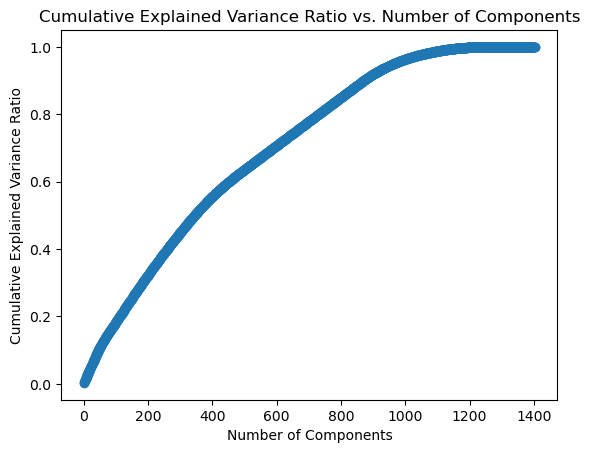

In [64]:
# plot cumulative explained variance ratio
plt.plot(range(1, len(explained_variance_ratio_cumulative) + 1), explained_variance_ratio_cumulative, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Cumulative Explained Variance Ratio vs. Number of Components')
plt.show()

In [65]:
# find the number of components that fall within 80% to 90% cumulative explained variance
target_variance_range = (0.80, 0.90)
target_components = np.where((explained_variance_ratio_cumulative >= target_variance_range[0]) &
                             (explained_variance_ratio_cumulative <= target_variance_range[1]))[0][0] + 1

print("Ideal number of components within 80% to 90% variance range:", target_components)

Ideal number of components within 80% to 90% variance range: 730


Out of the 1404 columns in the dataframe, only 730 will be used to build the model justified by PCA. 

### Data Splitting

In [66]:
# create a copy of df
ca_df = encoded_standardized.copy()

In [67]:
# split the dataset to predict whether death was intentional 
X = ca_df
y = force_df #Intentional_Use_of_Force_(Developing)is stored in its own df 

# split data into 60/40 split creating a temp set to store the validation and test
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)

# split reaming data from temp ste into test and validation 50/50 split 
X_valid, X_test, y_valid, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# scale the train & test set
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
X_valid_scaled = scaler.transform(X_valid)

# Apply PCA with 730 components
n_components = 730
pca = PCA(n_components=n_components)
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)
X_valid_pca = pca.transform(X_valid_scaled)


# print the dimensions of X_train_pca and X_test_pca
print("Dimensions of X_train_pca:", X_train_pca.shape)
print("Dimensions of X_test_pca:", X_test_pca.shape)
print("Dimensions of X_valid_pca:", X_valid_pca.shape)

Dimensions of X_train_pca: (2728, 730)
Dimensions of X_test_pca: (910, 730)
Dimensions of X_valid_pca: (910, 730)


In [76]:
original_feature_names = pca_df.columns
# create df for PCA-transformed data with original feature names from pca_df
selected_feature_indices = pca.components_.argsort()[:, ::-1][:, :n_components]
selected_feature_names = original_feature_names[selected_feature_indices[0]]
X_train_pca_df = pd.DataFrame(X_train_pca, columns=selected_feature_names)
X_test_pca_df = pd.DataFrame(X_test_pca, columns=selected_feature_names)

## Models

### Naive Bayes

In [68]:
# build and fit the Naive Bayes classifier 
nb_clf = GaussianNB()

# fit to data 
nb_clf.fit(X_train_pca, y_train)

# predict on the train set
nb_pred = nb_clf.predict(X_train_pca)
nb_prob = nb_clf.predict_proba(X_train_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_train, nb_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

nb_specificity = tn / (tn + fp)
nb_sensitivity = tp / (tp + fn)
nb_f1 = f1_score(y_train, nb_pred, pos_label='Intentional Use of Force, Deadly')
nb_acc = accuracy_score(y_train, nb_pred)
nb_roc_auc = roc_auc_score(y_train, nb_prob)

print ("Train Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", nb_acc)
print("Specificity:", nb_specificity)
print("Sensitivity (Recall):", nb_sensitivity)
print("F1 Score:", nb_f1)
print("ROC-AUC Score:", nb_roc_auc)

Train Set Metrics
Confusion Matrix:
[[1684  327]
 [ 442  275]]
Accuracy: 0.718108504398827
Specificity: 0.8373943311785181
Sensitivity (Recall): 0.38354253835425384
F1 Score: 0.8141165095479816
ROC-AUC Score: 0.7301886347543185


In [69]:
# define the hyperparameter grid
param_grid = {
    'var_smoothing': [1e-9, 1e-8, 1e-7],
}

# create new Gradient Boosting classifier
nb_clf = GaussianNB()

# preform grid search with cross validation and fit to data
grid_search = GridSearchCV(nb_clf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train_scaled, y_train)

# get the best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

Best Parameters: {'var_smoothing': 1e-09}
Best Estimator: GaussianNB()


In [70]:
# build and fit new Multilayer Perceptron classifier 
nb_clf = GaussianNB(var_smoothing = 1e-09)

# fit to data 
nb_clf.fit(X_train_pca, y_train)

# predict on the test set
nb_pred = nb_clf.predict(X_test_pca)
nb_prob = nb_clf.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, nb_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

nb_2_specificity = tn / (tn + fp)
nb_2_sensitivity = tp / (tp + fn)
nb_2_f1 = f1_score(y_test, nb_pred, pos_label='Intentional Use of Force, Deadly')
nb_2_acc = accuracy_score(y_test, nb_pred)
nb_roc2_auc = roc_auc_score(y_test, nb_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", nb_2_acc)
print("Specificity:", nb_2_specificity)
print("Sensitivity (Recall):", nb_2_sensitivity)
print("F1 Score:", nb_2_f1)
print("ROC-AUC Score:", nb_roc2_auc)

Test Set Metrics
Confusion Matrix:
[[547 103]
 [193  67]]
Accuracy: 0.6747252747252748
Specificity: 0.8415384615384616
Sensitivity (Recall): 0.25769230769230766
F1 Score: 0.7870503597122301
ROC-AUC Score: 0.6712958579881656


### Gradient Boosting

In [71]:
# build and fit the Gradient Boosting classifier 
gb_clf = GradientBoostingClassifier(random_state=42)

# fit model to data 
gb_clf.fit(X_train_pca, y_train)

# predict on the train set
gb_pred = gb_clf.predict(X_train_pca)
gb_prob = gb_clf.predict_proba(X_train_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_train, gb_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

gb_specificity = tn / (tn + fp)
gb_sensitivity = tp / (tp + fn)
gb_f1 = f1_score(y_train, gb_pred, pos_label='Intentional Use of Force, Deadly')
gb_acc = accuracy_score(y_train, gb_pred)
gb_roc_auc = roc_auc_score(y_train, gb_prob)

print ("Train Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", gb_acc)
print("Specificity:", gb_specificity)
print("Sensitivity (Recall):", gb_sensitivity)
print("F1 Score:", gb_f1)
print("ROC-AUC Score:", gb_roc_auc)

Train Set Metrics
Confusion Matrix:
[[2011    0]
 [   6  711]]
Accuracy: 0.9978005865102639
Specificity: 1.0
Sensitivity (Recall): 0.9916317991631799
F1 Score: 0.9985104270109235
ROC-AUC Score: 0.9999902905012668


In [72]:
# define the hyperparameter grid
param_grid = {
    'learning_rate': [0.01, 0.1, 0.2],
    'n_estimators': [50, 100, 200],
    'max_depth': [3, 4, 5],
    'subsample': [0.8, 1.0],
}

# create a new Gradient Boosting classifier
gb_clf = GradientBoostingClassifier(random_state=42)

# preform grid search with cross validation and fit to data
grid_search = GridSearchCV(gb_clf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train_scaled, y_train)

# get best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

KeyboardInterrupt: 

In [73]:
# build and fit the Gradient Boosting classifier using best parameters
gb_clf= GradientBoostingClassifier(learning_rate=0.2, 
                                   max_depth=4,
                                   n_estimators=200,
                                   random_state=42, 
                                   subsample=0.8)
gb_clf.fit(X_train_pca, y_train)

# predict on the test set
gb_pred = gb_clf.predict(X_test_pca)
gb_prob = gb_clf.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, gb_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

gb_2_specificity = tn / (tn + fp)
gb_2_sensitivity = tp / (tp + fn)
gb_2_f1 = f1_score(y_test, gb_pred, pos_label='Intentional Use of Force, Deadly')
gb_2_acc = accuracy_score(y_test, gb_pred)
gb_roc2_auc = roc_auc_score(y_test, gb_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", gb_2_acc)
print("Specificity:", gb_2_specificity)
print("Sensitivity (Recall):", gb_2_sensitivity)
print("F1 Score:", gb_2_f1)
print("ROC-AUC Score:", gb_roc2_auc)

KeyboardInterrupt: 

### Multilayer Perceptron 

In [90]:
# build and fit the Multilayer Perceptron classifier 
mlp_clf = MLPClassifier(random_state=42)
mlp_clf.fit(X_train_pca, y_train)

# predict on the train set
mlp_pred = mlp_clf.predict(X_train_pca)
mlp_prob = mlp_clf.predict_proba(X_train_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_train, mlp_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

mlp_specificity = tn / (tn + fp)
mlp_sensitivity = tp / (tp + fn)
mlp_f1 = f1_score(y_train, mlp_pred, pos_label='Intentional Use of Force, Deadly')
mlp_acc = accuracy_score(y_train, mlp_pred)
mlp_roc_auc = roc_auc_score(y_train, mlp_prob)

print ("Train Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", mlp_acc)
print("Specificity:", mlp_specificity)
print("Sensitivity (Recall):", mlp_sensitivity)
print("F1 Score:", mlp_f1)
print("ROC-AUC Score:", mlp_roc_auc)

Train Set Metrics
Confusion Matrix:
[[2011    0]
 [   0  717]]
Accuracy: 1.0
Specificity: 1.0
Sensitivity (Recall): 1.0
F1 Score: 1.0
ROC-AUC Score: 1.0


In [ ]:
# define the hyperparameter grid
param_grid = {
    'hidden_layer_sizes': [(100,), (50, 50), (100, 50)],
    'activation': ['relu', 'tanh'],
    'learning_rate_init': [0.001, 0.01],
    'max_iter': [200, 300],
}

# create a new Multilayer Perceptron classifier
mlp_clf = MLPClassifier(random_state=42)

# preform grid search with cross validation and fit to data
grid_search = GridSearchCV(mlp_clf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train_scaled, y_train)

# get the best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

In [89]:
# build and fit new Multilayer Perceptron classifier 
mlp_clf = MLPClassifier(hidden_layer_sizes=(50, 50), 
                        learning_rate_init=0.01,
                        random_state=42)

mlp_clf.fit(X_train_pca, y_train)

# predict on the test set
mlp_pred = mlp_clf.predict(X_test_pca)
mlp_prob = mlp_clf.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, mlp_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

mlp_2_specificity = tn / (tn + fp)
mlp_2_sensitivity = tp / (tp + fn)
mlp_2_f1 = f1_score(y_test, mlp_pred, pos_label='Intentional Use of Force, Deadly')
mlp_2_acc = accuracy_score(y_test, mlp_pred)
mlp_roc2_auc = roc_auc_score(y_test, mlp_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", mlp_2_acc)
print("Specificity:", mlp_2_specificity)
print("Sensitivity (Recall):", mlp_2_sensitivity)
print("F1 Score:", mlp_2_f1) 
print("ROC-AUC Score:", mlp_roc2_auc)

Test Set Metrics
Confusion Matrix:
[[628  22]
 [ 26 234]]
Accuracy: 0.9472527472527472
Specificity: 0.9661538461538461
Sensitivity (Recall): 0.9
F1 Score: 0.9631901840490797
ROC-AUC Score: 0.9615384615384616


### Linear Discriminant Analysis

In [ ]:
# define LDA model and fit to data 
lda_clf = LinearDiscriminantAnalysis()
lda_clf.fit(X_train_pca, y_train)

# predict on training data 
lda_pred = lda_clf.predict(X_train_pca)
lda_prob = lda_clf.predict_proba(X_train_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_train, lda_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

lda_specificity = tn / (tn + fp)
lda_sensitivity = tp / (tp + fn)
lda_f1 = f1_score(y_train, lda_pred, pos_label='Intentional Use of Force, Deadly') 
lda_acc = accuracy_score(y_train, lda_pred)
lda_roc_auc = roc_auc_score(y_train, lda_prob)

print ("Train Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", lda_acc)
print("Specificity:", lda_specificity)
print("Sensitivity (Recall):", lda_sensitivity)
print("F1 Score:", lda_f1)
print("ROC-AUC Score:", lda_roc_auc)

In [ ]:
# define the hyperparameter grid for LDA
param_grid = {
    'solver': ['lsqr', 'eigen', 'svd'],
    'shrinkage': [None, 'auto', 0.1, 0.2, 0.3],
    'priors': [None, [0.3, 0.7], [0.4, 0.6], [0.5, 0.5]],
}

# create a new LDA classifier
lda_clf = LinearDiscriminantAnalysis()

# perform grid search with cross-validation and fit to data
grid_search = GridSearchCV(lda_clf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train, y_train)

# get the best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

In [88]:
# build and fit LDA classifier using best parameters
lda_clf = LinearDiscriminantAnalysis(shrinkage=0.2,
                                     solver='lsqr')

lda_clf.fit(X_train_pca, y_train)

# predict on the test set            
lda_pred = lda_clf.predict(X_test_pca)
lda_prob = lda_clf.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, lda_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

lda_2_specificity = tn / (tn + fp)
lda_2_sensitivity = tp / (tp + fn)
lda_2_f1 = f1_score(y_test, lda_pred, pos_label='Intentional Use of Force, Deadly')  
lda_2_acc = accuracy_score(y_test, lda_pred)
lda_roc2_auc = roc_auc_score(y_test, lda_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", lda_2_acc)
print("Specificity:", lda_2_specificity)
print("Sensitivity (Recall):", lda_2_sensitivity)
print("F1 Score:", lda_2_f1)
print("ROC-AUC Score:", lda_roc2_auc)

Test Set Metrics
Confusion Matrix:
[[632  18]
 [ 41 219]]
Accuracy: 0.9351648351648352
Specificity: 0.9723076923076923
Sensitivity (Recall): 0.8423076923076923
F1 Score: 0.9554043839758125
ROC-AUC Score: 0.9859881656804734


### Logistic Regression

In [ ]:
# # define models and parameters 
# model = LogisticRegression()
# solvers = ['newton-cg', 'lbfgs', 'liblinear']
# penalty = ['l2']
# c_values = [100, 10, 1.0, 0.1, 0.01]
# # define grid search
# grid = dict(solver=solvers,penalty=penalty,C=c_values)
# cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1,
#                            cv=cv, scoring='accuracy',error_score=0)
# grid_result = grid_search.fit(X_train_pca, y_train)
# # summarize results
# print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
# means = grid_result.cv_results_['mean_test_score']
# stds = grid_result.cv_results_['std_test_score']
# params = grid_result.cv_results_['params']
# for mean, stdev, param in zip(means, stds, params):
#     print("%f (%f) with: %r" % (mean, stdev, param))

In [74]:
# fit logistic regression
logit_reg = LogisticRegression(penalty='l2', C=0.1, solver='newton-cg')
logit_reg.fit(X_train_pca, y_train)

LogisticRegression(C=0.1, solver='newton-cg')

In [77]:
print('intercept: ', logit_reg.intercept_[0])
pd.DataFrame({'coeff': logit_reg.coef_[0]}, index=X_train_pca_df.columns)

intercept:  -2.801706264895774


,coeff
"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_No",0.920174
Subjects_gender_Female,-0.353387
Cause_of_death_Vehicle,-1.220152
Unique_ID,0.169913
"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Pending investigation",-0.053203
...,...
Location_of_death_(city)_Berry Creek,0.242443
"Agency_responsible_for_death_Hemet Police Department, San Bernardino County Sheriff's Office",-0.080228
Location_of_death_(city)_Douglas City,-0.141798
Location_of_death_(city)_Dixie Valley,-0.063473


In [78]:
# predict on the test set            
lda_pred = logit_reg.predict(X_test_pca)
lda_prob = logit_reg.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, lda_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

lg_specificity = tn / (tn + fp)
lg_sensitivity = tp / (tp + fn)
lg_f1 = f1_score(y_test, lda_pred, pos_label='Intentional Use of Force, Deadly')  
lg_acc = accuracy_score(y_test, logit_reg.predict(X_test_pca))
lg_auc = roc_auc_score(y_test, lda_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", lg_acc)
print("Specificity:", lg_specificity)
print("Sensitivity (Recall):", lg_sensitivity)
print("F1 Score:", lg_f1)
print("ROC-AUC Score:", lg_auc)

Test Set Metrics
Confusion Matrix:
[[635  15]
 [ 16 244]]
Accuracy: 0.9659340659340659
Specificity: 0.9769230769230769
Sensitivity (Recall): 0.9384615384615385
F1 Score: 0.9761721752498077
ROC-AUC Score: 0.9796153846153847


### Random Forest

In [ ]:
# model = RandomForestClassifier()
# n_estimators = [ 100, 1000, 2000]
# max_features = ['sqrt', 'log2']
# # define grid search
# grid = dict(n_estimators=n_estimators,max_features=max_features)
# cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy',error_score=0)
# grid_result = grid_search.fit(X_train_pca, y_train)
# # summarize results
# print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
# means = grid_result.cv_results_['mean_test_score']
# stds = grid_result.cv_results_['std_test_score']
# params = grid_result.cv_results_['params']
# for mean, stdev, param in zip(means, stds, params):
#     print("%f (%f) with: %r" % (mean, stdev, param))

In [79]:
# fit random forest with the parameters
rf = RandomForestClassifier(n_estimators=2000, max_features='sqrt', random_state=1)
rf.fit(X_train_pca, y_train)

RandomForestClassifier(n_estimators=2000, random_state=1)

In [80]:
# variable importance plot
importances = rf.feature_importances_
std = np.std([tree.feature_importances_ for tree in rf.estimators_], axis=0)
df = pd.DataFrame({'feature': X_train_pca_df.columns, 'importance': importances, 'std': std})
df = df.sort_values('importance')
print(df)

                                               feature  importance       std
532  Agency_responsible_for_death_Rialto Police Dep...    0.000510  0.001741
476  Agency_responsible_for_death_Buena Park Police...    0.000520  0.001804
473  Agency_responsible_for_death_San Jose State Un...    0.000525  0.001858
502              Location_of_death_(city)_Willow Creek    0.000536  0.001824
490  Agency_responsible_for_death_Victor Valley Com...    0.000536  0.001735
..                                                 ...         ...       ...
54   Agency_responsible_for_death_Oakland Police De...    0.013312  0.018355
56   Agency_responsible_for_death_Richmond Police D...    0.015065  0.023965
49   Agency_responsible_for_death_Dinuba Police Dep...    0.020542  0.030243
0    Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_...    0.023061  0.031190
2                               Cause_of_death_Vehicle    0.041364  0.047183

[730 rows x 3 columns]


In [81]:
# predict on the test set            
lda_pred = rf.predict(X_test_pca)
lda_prob = rf.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, lda_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

rf_specificity = tn / (tn + fp)
rf_sensitivity = tp / (tp + fn)
rf_f1 = f1_score(y_test, lda_pred, pos_label='Intentional Use of Force, Deadly')  
rf_acc = accuracy_score(y_test, lda_pred)
rf_auc = roc_auc_score(y_test, lda_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", rf_acc)
print("Specificity:", rf_specificity)
print("Sensitivity (Recall):", rf_sensitivity)
print("F1 Score:", rf_f1)
print("ROC-AUC Score:", rf_auc)

Test Set Metrics
Confusion Matrix:
[[634  16]
 [136 124]]
Accuracy: 0.832967032967033
Specificity: 0.9753846153846154
Sensitivity (Recall): 0.47692307692307695
F1 Score: 0.8929577464788733
ROC-AUC Score: 0.9614733727810651


### Neural Network

In [82]:
# fit neural network
clf = MLPClassifier(hidden_layer_sizes=(3), activation='logistic', solver='lbfgs',random_state=1, max_iter=1000)
clf.fit(X_train_pca,y_train)

MLPClassifier(activation='logistic', hidden_layer_sizes=3, max_iter=1000,
              random_state=1, solver='lbfgs')

In [83]:
# network structure
print('Intercepts')
print(clf.intercepts_)
print('Weights')
print(clf.coefs_)

Intercepts
[array([ 4.0107973 ,  1.45494973, -0.55079978]), array([-0.61299365])]
Weights
[array([[-2.21880280e+00, -1.64451569e+01,  1.58975737e+00],
       [ 1.20764078e+00,  5.73474191e+00,  3.40239340e-02],
       [ 3.79110889e+00,  1.86682505e+01, -1.72757825e+00],
       ...,
       [ 1.12718395e+00,  9.04166547e-01, -2.54043921e-01],
       [-5.77965822e-01, -2.16446472e-01, -9.03649237e-03],
       [-1.00084888e+00, -1.61133139e-01,  6.64254913e-01]]), array([[-13.59500043],
       [-10.06012679],
       [  9.52455987]])]


In [84]:
# predict on the test set            
lda_pred = clf.predict(X_test_pca)
lda_prob = clf.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, lda_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

clf_specificity = tn / (tn + fp)
clf_sensitivity = tp / (tp + fn)
clf_f1 = f1_score(y_test, lda_pred, pos_label='Intentional Use of Force, Deadly')  
clf_acc = accuracy_score(y_test, lda_pred)
clf_auc = roc_auc_score(y_test, lda_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", clf_acc)
print("Specificity:", clf_specificity)
print("Sensitivity (Recall):", clf_sensitivity)
print("F1 Score:", clf_f1)
print("ROC-AUC Score:", clf_auc)

Test Set Metrics
Confusion Matrix:
[[622  28]
 [ 35 225]]
Accuracy: 0.9307692307692308
Specificity: 0.9569230769230769
Sensitivity (Recall): 0.8653846153846154
F1 Score: 0.9517980107115531
ROC-AUC Score: 0.9694940828402366


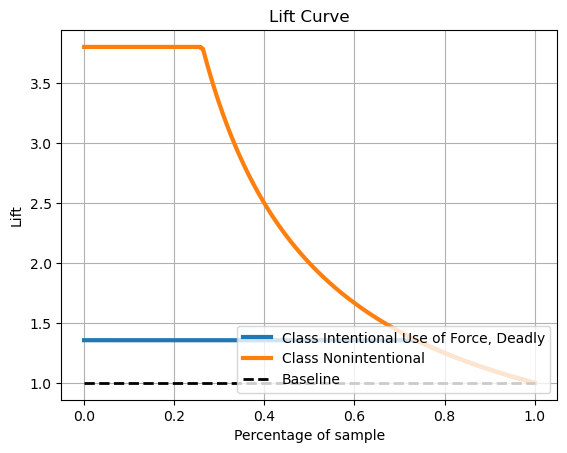

In [85]:
# define predicted with the probabilities from the model
predicted = logit_reg.predict_proba(X_train_pca)

#plot the predicted and initial values.
skplt.metrics.plot_lift_curve(y_train, predicted)
plt.show()

## Results

In [91]:
# displaying all reuslts in a df 

# create lists to store the scores
model_names = ["MLP Classifier", "Naive Bayes", "Gradient Boosting", "Linear Discriminant Analysis",
              "Logistic Regression", "Random Forest", "Neural Network"]
accuracies = [mlp_2_acc, nb_2_acc, gb_2_acc, lda_2_acc, lg_acc, rf_acc, clf_acc]
specificities = [mlp_2_specificity, nb_2_specificity, gb_2_specificity, lda_2_specificity
                , lg_specificity, rf_specificity, clf_specificity]
sensitivities = [mlp_2_sensitivity, nb_2_sensitivity, gb_2_sensitivity, lda_2_sensitivity,
                 lg_sensitivity, rf_sensitivity, clf_sensitivity]
f1_scores = [mlp_2_f1, nb_2_f1, gb_2_f1, lda_2_f1, lg_f1, rf_f1, clf_f1]
roc_auc = [mlp_roc2_auc, nb_roc2_auc, gb_roc2_auc, lda_roc2_auc, lg_auc, rf_auc, clf_auc]

# create df
scores_df = pd.DataFrame({
    "Model": model_names,
    "Accuracy": accuracies,
    "Specificity": specificities,
    "Sensitivity (Recall)": sensitivities,
    "F1 Score": f1_scores,
    "ROC - AUC Score": roc_auc 
})

scores_df

NameError: name 'gb_2_acc' is not defined